In [1]:
import os
import sys

import numpy as np  
import pandas as pd 

import sklearn
import tensorflow as tf
from tensorflow import keras

%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt

import glob
import imageio

import math
import random
import time
import datetime
import shutil
from tqdm import tqdm, tqdm_notebook


from dataclasses import dataclass
from pathlib import Path
import warnings
from scipy import linalg

import xml.etree.ElementTree as ET 

import cv2
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

from IPython import display
from IPython.display import Image as IpyImage

from tensorflow.keras.models import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import UpSampling2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Add
from tensorflow.keras.layers import Layer

from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.metrics import Accuracy

from tensorflow.keras.models import save_model
from tensorflow.keras.models import load_model

from tensorflow.keras import backend as K

import pickle


Bad key "text.kerning_factor" on line 4 in
/anaconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


In [3]:
%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
    raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
    print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
    print('and then re-execute this cell.')
else:
    print(gpu_info)

Found GPU at: /device:GPU:0
Tue Jul 14 04:45:07 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.51.05    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   70C    P0    54W / 250W |    353MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                            

In [2]:
try: # detect TPUs
    # detect and init the TPU
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)

    # instantiate a distribution strategy
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except ValueError: # detect GPUs
    #strategy = tf.distribute.MirroredStrategy() # for GPU or multi-GPU machines
    strategy = tf.distribute.get_strategy() # default strategy that works on CPU and single GPU
    #strategy = tf.distribute.experimental.MultiWorkerMirroredStrategy() # for clusters of multi-GPU machines

AUTO = tf.data.experimental.AUTOTUNE
print("Number of accelerators: ", strategy.num_replicas_in_sync)

FishDIR='../../CustomFish/'
GIFDIR = "./"
h5inDIR = "./"
h5DIR = "./"

Number of accelerators:  1


In [3]:
codings_size = 256
dropoutVal = 0.4
LReluAlpha = 0.2

##############
### Layers ###
##############

# from 1710.10196 use mini batch standard dev on discriminator output (only needs to be done once)
# need to combine layers to fade out, inherit Add class
# fade parameter is updated in WGANGP class
class AddWithFade(Add):
    def __init__(self, fade=0.0, **kwargs):
        super(AddWithFade, self).__init__(**kwargs)
        # fade will increase linearly from 0-1 
        self.fade = K.variable(fade, name='fade_param')
 
    def _merge_function(self, inputs):
        assert (len(inputs) == 2)
        #input[0] = lower res layer, input[1] = higher res layer 
        output = ((1. - self.fade) * inputs[0]) + (self.fade * inputs[1])
        return output
    
    def get_config(self):
        base_config = super(AddWithFade, self).get_config()
        base_config["fade"] = self.fade
        return base_config

# update the fade parameter in the model
def update_fade(model,newfade):
    for layer in model.layers:
        if isinstance(layer, AddWithFade):
            K.set_value(layer.fade,newfade)
    
# toggle trainability of WGAN
def toggle_train(WGAN, trainTog=True, size=codings_size):
    if trainTog == False:
        WGAN.trainFreeze = True
        for layer in WGAN.discriminator.layers:
            if layer.output.shape[1] != size:
                layer.trainable = False
        for layer in WGAN.generator.layers:
            if layer.output.shape[1] != size:
                layer.trainable = False
    else:
        WGAN.trainFreeze = False
        for layer in WGAN.discriminator.layers:
            layer.trainable = True
        for layer in WGAN.generator.layers:
            layer.trainable = True     
            
# this has the generator creating realistic deviations across batches
# useful discussion: https://towardsdatascience.com/gan-ways-to-improve-gan-performance-acf37f9f59b
# "We append the similarity o(x) in one of the dense layers in the discriminator
#  to classify whether this image is real or generated. If the mode starts to collapse, 
#  the similarity of generated images increases. The discriminator can use this score 
#  to detect generated images and penalize the generator if mode is collapsing."
class MBStDev(Layer):
    def __init__(self, **kwargs):
        self.smallParam = 1e-8 
        super(MBStDev, self).__init__(**kwargs)
 
    # perform the operation
    def call(self, ins):
        # mean value for each pixel across channels
        pixMean = K.mean(ins, axis=0, keepdims=True)
        # standard deviation across each pixel coord (small param regulates singularity)
        stDev = K.sqrt(K.mean(K.square(ins - pixMean), axis=0, keepdims=True)+self.smallParam)
        # mean standard deviation across each pixel coord
        meanStDev = K.mean(stDev, keepdims=True)
        # scale this up to be the size of one input feature map for each sample
        shape = K.shape(ins)
        outs = K.tile(meanStDev, (shape[0], shape[1], shape[2], 1))
        # concatenate with the output
        joinedInandOut = K.concatenate([ins, outs], axis=-1)
        return joinedInandOut
 
    # corrects the output shape to match the joint values
    def correct_output_shape(self, input_shape):
        # create a copy of the input shape as a list
        input_shape = list(input_shape)
        # add one to the channel dimension (assume channels-last)
        input_shape[-1] += 1
        # convert list to a tuple
        return tuple(input_shape)
    
    def get_config(self):
        base_config = super(MBStDev, self).get_config()
        return base_config

# from 1710.10196 - use pixel normalization, a variant of "local response normalization"
# Used to "disallow the scenario where the magnitudes in the generator and discriminator spiral out 
# of control as a result of competition" - apply BEFORE activation function in generator only
class PixelNorm(Layer):
    def __init__(self, **kwargs):
        self.smallParam = 1e-8 
        super(PixelNorm, self).__init__(**kwargs)
    
    def call(self, ins):
        # -1 is over the filters
        sqPixMean = K.mean(ins**2 + self.smallParam, axis=-1, keepdims=True)
        return ins / K.sqrt(sqPixMean)
    
    def get_config(self):
        base_config = super(PixelNorm, self).get_config()
        return base_config

# this kernel implements equalized learning rate
# adapted from https://github.com/keras-team/keras/blob/master/keras/layers/convolutional.py
class Conv2DELR(Conv2D):
    def __init__(self, *args, cHe=None, kernel_initializer=tf.keras.initializers.RandomNormal(stddev=1.), **kwargs):
        #if kernel_initializer != tf.keras.initializers.RandomNormal(stddev=1.):
        #    print("Warning:  overriding default kernel_initializer in Conv2DELR with {}".format(str(kernel_initializer)))
        if cHe is not None:
            self.c = cHe
        super().__init__(*args, kernel_initializer=kernel_initializer, **kwargs)

    def build(self, input_shape):
        super().build(input_shape)
        # The number of inputs
        n = np.product([int(val) for val in input_shape[1:]])
        # He initialisation constant
        self.c = np.sqrt(2/n)

    def call(self, inputs):
        if self.rank == 2:
            outputs = K.conv2d(
                inputs,
                self.kernel*self.c, # scale kernel
                strides=self.strides,
                padding=self.padding,
                data_format=self.data_format,
                dilation_rate=self.dilation_rate)

        if self.use_bias:
            outputs = K.bias_add(
                outputs,
                self.bias,
                data_format=self.data_format)

        if self.activation is not None:
            return self.activation(outputs)
        return outputs
    
    def get_config(self):
        base_config = super(Conv2D, self).get_config()
        base_config['cHe'] = self.c
        return base_config

############
### Loss ###
############

# from https://keras.io/examples/generative/wgan_gp/
# Define the loss functions to be used for discrimiator
# This should be (fake_loss - real_loss)
# We will add the gradient penalty later to this loss function
def critic_loss(real_img, fake_img):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    # 
    # this is a simple implementation of the drift loss
    epsilonDrift = 0.001
    epsilonLoss = epsilonDrift * tf.reduce_mean(tf.nn.l2_loss(real_img))
    return fake_loss - real_loss + epsilonLoss

# Define the loss functions to be used for generator
def generator_loss(fake_img):
    return -tf.reduce_mean(fake_img)

#################
### Optimizer ###
#################

## learning rate modifcations
def set_lr(opt, lr):
    opt.lr = lr

def adapt_lr_GAN(optg, optd, histg, histd, lrmax=0.001, lrmin=0.00001):
    pauseFade = False
    if len(hist1) > 20: 
        rhg = histg[-20:]
        rhd = histd[-20:]
        hdiff = rhg - rhd
        avg = np.mean(rhg)
        avd = np.mean(rhd)
        avdiff = np.mean(hdiff)
        changeg = np.mean(rhg[-10:])-np.mean(rhg[:10])
        changed = np.mean(rhd[-10:])-np.mean(rhd[:10])
        changediff = np.mean(hdiff[-10:])-np.mean(hdiff[:10])
        stdg = np.std(rhg)
        stdd = np.std(rhd)
        stddiff = np.std(hdiff)
        if 3*stdg > stddiff:
            optg.lr = max(optg.lr/2,lrmin)
            optd.lr = max(optd.lr/2,lrmin)
            print("Cond 1 adapt: ".format(optg.lr))
        elif changeg > 5 and avg > 30:
            optg.lr = min(2*optg.lr,lrmax)
            optg.lr = min(2*optg.lr,lrmax)
            print("Cond 2 adapt: ".format(optg.lr))
            pauseFade = True
        elif stdg > changeg and avd < 0:
            optg.lr = max(optg.lr/2,lrmin)
            optd.lr = max(optd.lr/2,lrmin)
            print("Cond 3 adapt: ".format(optg.lr))
        print("avg {}; delg {}; stdg {}".format(avg,changeg, stdg))
        print("avd {}; deld {}; stdd {}".format(avg,changeg, stdg))
        print("avdiff {}; deldiff {}; stddiff {}".format(avg,changeg, stdg))
    return pauseFade

def adjust_lr(opt,lrmax=0.001,lrmin=0.0001):
    # randomly assign a learning rate to both the discriminator and generator each iteration
    newlr = 1./(1./lrmax + tf.random.uniform(shape=(),maxval=1./lrmin))
    opt.lr = newlr

def adjust_lr_prob(opt,lrhigh=0.005,prob=0.003,lrmax=0.001,lrmin=0.0001):#,lrmax=0.001,lrmin=0.0001):
    # randomly assign a learning rate to both the discriminator and generator each iteration
    if tf.random.uniform(shape=(),maxval=1.) < prob:
        opt.lr = lrhigh
    else:
        adjust_lr(opt,lrmax=lrmax,lrmin=lrmin)

        
#############
### Model ###
#############

# implementation of wasserstein loss with gradient penalty
# Useful information: https://medium.com/@jonathan_hui/gan-wasserstein-gan-wgan-gp-6a1a2aa1b490
# keras implementation: https://keras.io/examples/generative/wgan_gp/
class WGANGP(keras.Model):
    def __init__(
        self,
        discriminator,
        generator,
        latent_dim,
        discriminator_steps=1,
        gp_weight=10.0,
        #nMaxFade = 800000 this is the recommended value for faces
        nMaxFade = 100000
    ):
        super(WGANGP, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_steps = discriminator_steps
        self.gp_weight = gp_weight
        self.nMaxFade = nMaxFade
        self.fade = 0.0
        self.nRunFade = 0
        self.trainFreeze = False

    def compile(self, d_optimizer, g_optimizer, d_loss_fn, g_loss_fn):
        super(WGANGP, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_fn = d_loss_fn
        self.g_loss_fn = g_loss_fn
        
    def get_config(self):
        base_config = super(keras.Model,self).get_config()
        base_config["discriminator"] = self.discriminator
        base_config["d_optimizer"] = self.d_optimizer
        base_config["d_loss_fn"] = self.d_loss_fn
        base_config["generator"] = self.generator
        base_config["g_loss_fn"] = self.g_loss_fn
        base_config["g_optimizer"] = self.g_optimizer
        base_config["latent_dim"] = self.latent_dim
        base_config["discriminator_steps"] = self.d_steps
        base_config["gp_weight"] = self.gp_weight
        base_config["nMaxFade"] = self.nMaxFade
        return base_config

    def gradient_penalty(self, batch_size, real_images, fake_images):
        """ Calculates the gradient penalty.

        This loss is calculated on an interpolated image
        and added to the discriminator loss.
        """
        # get the interplated image
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            # 1. Get the discriminator output for this interpolated image.
            pred = self.discriminator(interpolated, training=True)

        # 2. Calculate the gradients w.r.t to this interpolated image.
        grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Calcuate the norm of the gradients
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images, withFade = True, adaptlr = False, randg=False, randd=False):
        if isinstance(real_images, tuple):
            real_images = real_images[0]

        # Get the batch size
        batch_size = tf.shape(real_images)[0]
        
        #print("Batch Size {}".format(batch_size))
        
        # update the fade is model is being run with fade
        if self.fade < 1:
            if withFade and not self.trainFreeze:
                self.nRunFade += batch_size
                self.fade = min(self.nRunFade,self.nMaxFade)/self.nMaxFade
                update_fade(self.generator,self.fade)
                update_fade(self.discriminator,self.fade)

        # For each batch, we are going to perform the
        # following steps as laid out in the original paper.
        # 1. Train the generator and get the generator loss
        # 2. Train the discriminator and get the discriminator loss
        # 3. Calculate the gradient penalty
        # 4. Multiply this gradient penalty with a constant weight factor
        # 5. Add gradient penalty to the discriminator loss
        # 6. Return generator and discriminator losses as a loss dictionary.

        # Train discriminator first. The original paper recommends training
        # the discriminator for `x` more steps (typically 5) as compared to
        # one step of the generator. Here we will train it for 3 extra steps
        # as compared to 5 to reduce the training time.
        for i in range(self.d_steps):
            # Get the latent vector
            random_latent_vectors = tf.random.normal(
                shape=(batch_size, self.latent_dim)
            )
            with tf.GradientTape() as tape:
                # Generate fake images from the latent vector
                fake_images = self.generator(random_latent_vectors, training=True)
                # Get the logits for the fake images
                fake_logits = self.discriminator(fake_images, training=True)
                # Get the logits for real images
                real_logits = self.discriminator(real_images, training=True)

                # Calculate discriminator loss using fake and real logits
                d_cost = self.d_loss_fn(real_img=real_logits, fake_img=fake_logits)
                # Calculate the gradient penalty
                gp = self.gradient_penalty(batch_size, real_images, fake_images)
                # Add the gradient penalty to the original discriminator loss
                d_loss = d_cost + gp * self.gp_weight

            if randd:
                adjust_lr(self.d_optimizer)
            # Get the gradients w.r.t the discriminator loss
            d_gradient = tape.gradient(d_loss, self.discriminator.trainable_variables)
            # Update the weights of the discriminator using the discriminator optimizer
            
            self.d_optimizer.apply_gradients(
                zip(d_gradient, self.discriminator.trainable_variables)
            )

        # Train the generator now.
        # Get the latent vector
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            # Generate fake images using the generator
            generated_images = self.generator(random_latent_vectors, training=True)
            # Get the discriminator logits for fake images
            gen_img_logits = self.discriminator(generated_images, training=True)
            # Calculate the generator loss
            g_loss = self.g_loss_fn(gen_img_logits)

        if randg:
            adjust_lr_prob(self.g_optimizer)
        # Get the gradients w.r.t the generator loss
        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        # Update the weights of the generator using the generator optimizer
        
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )
        return {"d_loss": d_loss, "g_loss": g_loss}

# take from a model that criticises an nxnx3 figure to one that criticizes a 2nx2nx3 figure
def add_critic_level(old_c_model, new_level=8, nSkip=3,nSkipPassby=1,nColors=3,nameX=None):
    namebase = nameX
    if nameX == None:
        namebase = str(new_level)
        
    thisleveldict = leveldict[new_level]
    filters = thisleveldict['filters']
    conv2filters = leveldict[new_level/2]['filters']
    
    #define new input layer
    layer_in = Input(shape=(new_level, new_level, nColors,),name="Input_C0_{}".format(namebase)) 
    
    # new round start passby here
    conv_0 = Conv2DELR(filters, (1,1), padding="SAME",name="Conv_C0_{}".format(namebase))(layer_in)
    act_0 = LeakyReLU(alpha=0.2,name="Act_C0_{}".format(namebase))(conv_0)
    # first layer set (newround start main model here)
    conv_1 = Conv2DELR(filters, (3,3), padding="SAME",name="Conv_C1_{}".format(namebase))(act_0)
    act_1 = LeakyReLU(alpha=0.2,name="Act_C1_{}".format(namebase))(conv_1)
    # second layer set
    conv_2 = Conv2DELR(conv2filters, (3,3), padding="SAME",name="Conv_C2_{}".format(namebase))(act_1)
    act_2 = LeakyReLU(alpha=0.2,name="Act_C2_{}".format(namebase))(conv_2)
    newcriticlayers = AveragePooling2D(name="AvPool_C0_{}".format(namebase))(act_2)
    critic = newcriticlayers
    # append the earlier model
    for i in range(nSkip,len(old_c_model.layers)):
        critic = old_c_model.layers[i](critic)
    criticModel = Model(layer_in, critic)
    
    # define passby model, first downsample
    pathtofade = AveragePooling2D(name="AvPool_CPass_{}".format(namebase))(layer_in)
    # note: including conv_0, and act_0 from previous layer
    for i in range(nSkipPassby,nSkip):
        pathtofade = old_c_model.layers[i](pathtofade)
    critic_fade = AddWithFade(name="Fade_CPass_{}".format(namebase))([pathtofade,newcriticlayers])
    for i in range(nSkip,len(old_c_model.layers)):
        critic_fade = old_c_model.layers[i](critic_fade)
    criticFadeOut = Model(layer_in, critic_fade)
    return [criticModel, criticFadeOut]

# take from a model that generates an nxnx3 figure to one that generates a 2nx2nx3 figure
def add_generator_level(old_g_model, new_level=8, nDrop=3,nDropPassby=1,nColors=3,nameX=None):
    namebase = nameX
    if nameX == None:
        namebase = str(new_level)
        
    thisleveldict = leveldict[new_level]
    filters = thisleveldict['filters']
    
    # get input
    layer_in = old_g_model.input
    # remove final layer
    newendofold = old_g_model.layers[-2].output 
    sizeaugment = UpSampling2D(name="UpSample_G0_{}".format(namebase))(newendofold)
    
    # first layer set
    conv_1 = Conv2DELR(filters, (3,3), padding="SAME",name="Conv_G1_{}".format(namebase))(sizeaugment)
    pixnorm_1 = PixelNorm(name="Pix_G1_{}".format(namebase))(conv_1)
    act_1 = LeakyReLU(alpha=0.2,name="Act_G1_{}".format(namebase))(pixnorm_1)
    # second layer set
    conv_2 = Conv2DELR(filters, (3,3), padding="SAME",name="Conv_G2_{}".format(namebase))(act_1)
    pixnorm_2 = PixelNorm(name="Pix_G2_{}".format(namebase))(conv_2)
    act_2 = LeakyReLU(alpha=0.2,name="Act_G2_{}".format(namebase))(pixnorm_2)
    
    # save for combo below
    conv_out = Conv2DELR(nColors, (1,1), padding="SAME",name="Conv_Gout_{}".format(namebase))(act_2)
    genModel = Model(layer_in, conv_out)
    
    # define passby model
    #old_end = old_g_model.layers[-1].output
    #sizeaugment_fade = UpSampling2D(name="UpSample_GPass_{}".format(namebase))(old_end)
    old_end = old_g_model.layers[-1]
    sizeaugment_fade = old_end(sizeaugment)
    conv_out_fade = AddWithFade(name="Fade_GPass_{}".format(namebase))([sizeaugment_fade,conv_out])
    
    genModelFade = Model(layer_in, conv_out_fade)
    
    return [genModel, genModelFade]

# nLevels = number of pixelation levels (4,8,16,32,64,128) 
def create_critics(nColors=3, initialSize = 4, nLevels = 6):
    # first create the lowest level critic
    thisleveldict = leveldict[initialSize]
    filters = thisleveldict['filters']
    
    #define new input layer
    layer_in = Input(shape=(initialSize, initialSize, nColors,)) 
    # new round start passby here
    # define new input processing layer
    conv_0 = Conv2DELR(filters, (1,1), padding="SAME")(layer_in)
    act_0 = LeakyReLU(alpha=0.2)(conv_0)
    # first layer set (newround start main model here)
    # apply minibatch standard deviation
    miniBDev = MBStDev()(act_0)
    conv_1 = Conv2DELR(filters, (3,3), padding="SAME")(miniBDev)
    act_1 = LeakyReLU(alpha=0.2)(conv_1)
    # second layer set (the end is a 4x4 convolution)
    conv_2 = Conv2DELR(filters, (4,4), padding="SAME")(act_1)
    act_2 = LeakyReLU(alpha=0.2)(conv_2)
    dense_out = Flatten()(act_2)
    out_classifier = Dense(1)(dense_out)
    
    # define and compile model
    initial_critic = Model(layer_in,out_classifier)
    
    # collect all models
    modellist = [[initial_critic,initial_critic]]
    curlevel = 4
    for i in range(1,nLevels):
        curlevel = curlevel * 2
        # modellist[-1][0] corresponds to the version with no fade
        newmodels = add_critic_level(modellist[-1][0], new_level=curlevel)
        modellist.append(newmodels)
    return modellist


# nLevels = number of pixelation levels (4,8,16,32,64,128) 
def create_gens(nInputs = codings_size, nColors=3, initialSize = 4, nLevels = 6):
    # first create the lowest level critic
    thisleveldict = leveldict[initialSize]
    filters = thisleveldict['filters']
    # #4.1 weight initialization and maxnorm constraint
    kinit = tf.keras.initializers.RandomNormal(stddev=1.)
    
    #define new input layer
    layer_in = Input(shape=(nInputs,))
    dense_0 = Dense(nInputs*initialSize*initialSize, kernel_initializer=kinit)(layer_in)
    reshape_0 = Reshape((initialSize, initialSize, nInputs))(dense_0)
    #may want to add activiation functions
    # first layer set (start with 4x4)
    conv_1 = Conv2DELR(filters, (4,4), padding="SAME")(reshape_0)
    pixnorm_1 = PixelNorm()(conv_1)
    act_1 = LeakyReLU(alpha=0.2)(pixnorm_1)
    # second layer set 
    conv_2 = Conv2DELR(filters, (3,3), padding="SAME")(act_1)
    pixnorm_2 = PixelNorm()(conv_2)
    act_2 = LeakyReLU(alpha=0.2)(pixnorm_2)
    # save for combo below
    conv_out = Conv2DELR(nColors, (1,1), padding="SAME")(act_2)
    genModel = Model(layer_in, conv_out)
    
        
    # collect all models
    modellist = [[genModel,genModel]]
    curlevel = 4
    for i in range(1,nLevels):
        curlevel = curlevel * 2
        # modellist[-1][0] corresponds to the version with no fade
        newmodels = add_generator_level(modellist[-1][0], new_level=curlevel)
        modellist.append(newmodels)
    return modellist

def create_gans(gens,crits,nInputs = codings_size):
    ganlist = []
    assert len(gens)==len(crits), "Generators and Discriminators created with different lengths"
    for i in range(len(gens)):
        with strategy.scope():
            # compile standard
            wgan1 = WGANGP(discriminator=crits[i][0],generator=gens[i][0],latent_dim=nInputs,discriminator_steps=1)
            wgan1.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)
            # compile fade
            wgan2 = WGANGP(discriminator=crits[i][1],generator=gens[i][1],latent_dim=nInputs,discriminator_steps=1)
            wgan2.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)
            # add to gan list
            ganlist.append([wgan1,wgan2])
    return ganlist
 
########################
### Image processing ###
########################
datagen = ImageDataGenerator(
        rotation_range=25,
        width_shift_range=0.05,
        height_shift_range=0.1,
        shear_range=10,
        zoom_range=[0.95,1.2],
        brightness_range=[0.8,1.4],
        horizontal_flip=True,
        fill_mode='nearest')

# adjust the saturation of the image
def colorSaturationAdjust(img, satRange=[0.6,1.4]):
    rSat = random.triangular(satRange[0],satRange[1])
    gSat = random.triangular(satRange[0],satRange[1])
    bSat = random.triangular(satRange[0],satRange[1])
    satVar = [rSat, gSat, bSat]
    return np.clip(img * satVar,0,1)

def multiprocessingI(imglist):
    imglistproc = []
    for img in datagen.flow((imglist+1.)/2.000)[0]:
        imglistproc.append(np.clip(2.*(colorSaturationAdjust(img/255.0)-0.5),-1.,1.))
        #imglistproc.append(colorSaturationAdjust(img/255.0))
    return np.asarray(imglistproc)

def multiprocessingI(imglist,new_length,batch_size):
    imglistproc = []
    for img in datagen.flow((imglist+1.)/2.000,batch_size=batch_size)[0]:
        newimg = np.clip(2.*(colorSaturationAdjust(img/255.0)-0.5),-1.,1.)
        imglistproc.append(cv2.resize(newimg, (new_length,new_length), interpolation = cv2.INTER_AREA))
        #imglistproc.append(colorSaturationAdjust(img/255.0))
    return np.asarray(imglistproc)


##################################
### Image display and file I/O ###
##################################
def plot_multiple_images(images, n_cols=None):
    n_cols = n_cols or len(images)
    n_rows = (len(images) - 1) // n_cols + 1
    if images.shape[-1] == 1:
        images = np.squeeze(images, axis=-1)
    plt.figure(figsize=(n_cols, n_rows))
    plt.subplots_adjust(hspace=0.03, wspace=0)
    for index, image in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1,snap=True)
        plt.imshow(np.clip((image + 1.)/2.,0.,1.), cmap="binary")
        #plt.imshow(image, cmap="binary")
        plt.axis("off")

def read_image(src):
    img = cv2.imread(src)
    if img is None:
        print(src)
        raise FileNotFoundError
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

def write_image(img,filename):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    cv2.imwrite(filename, img)

def constructGIF(ix,filename):
    gif_path = GIFDIR+filename+".gif"
    frames_path = GIFDIR+filename+"_{i}.jpg"
    with imageio.get_writer(gif_path, mode='I') as writer:
        for i in range(ix):
            writer.append_data(imageio.imread(frames_path.format(i=i)))

#IpyImage(filename=GIFDIR+modelname+"_test.gif")

def plot_history(d_hist, g_hist):
    plt.plot(d_hist, label='crit')
    plt.plot(g_hist, label='gen')
    plt.legend()
    plt.show()
    plt.savefig(GIFDIR+'/plot_line_plot_loss.png')
    plt.close()
    
def saveh5(model, name):
    filename = h5DIR + name + '.h5'
    model.save(filename)

def saveh5s(model, name):
    saveh5(model.generator, 'gen_'+ name)
    saveh5(model.discriminator, 'crit_'+ name)

def write_images_and_GIF(imgsetforGIF,modelname):
    frames_path = GIFDIR+modelname+"_{i}.jpg"
    for i, imgs in enumerate(imgsetforGIF):
        plot_multiple_images(imgs, 8)
        plt.savefig(frames_path.format(i=i))
        plt.close()
    constructGIF(len(imgsetforGIF),modelname)

customOs={'LeakyReLU': LeakyReLU,'Conv2DELR': Conv2DELR,'PixelNorm':PixelNorm,
          'AddWithFade':AddWithFade,'MBStDev':MBStDev}
def loadh5s(name):
    filename = h5inDIR + 'gen_' +name + '.h5'
    generator = load_model(filename,custom_objects=customOs)
    filename = h5inDIR + 'crit_' +name + '.h5'
    critic = load_model(filename,custom_objects=customOs)
    return generator, critic

def load_hists(tag=""):
    with open(h5inDIR + 'g_loss_hist'+tag+'.dat', 'rb') as filehandle:
        # read the data as binary data stream
        g_loss_hist = pickle.load(filehandle)
    with open(h5inDIR + 'd_loss_hist'+tag+'.dat', 'rb') as filehandle:
        # read the data as binary data stream
        d_loss_hist = pickle.load(filehandle)
        return d_loss_hist, g_loss_hist

def dump_hists(d_loss_hist, g_loss_hist):
    with open(h5DIR + 'g_loss_hist.dat', 'wb') as filehandle:
        # store the data as binary data stream
        pickle.dump(g_loss_hist, filehandle)
    with open(h5DIR + 'd_loss_hist.dat', 'wb') as filehandle:
        # store the data as binary data stream
        pickle.dump(d_loss_hist, filehandle)

def dump_hists(d_loss_hist, g_loss_hist, tag=""):
    with open(h5DIR + 'g_loss_hist'+tag+'.dat', 'wb') as filehandle:
        # store the data as binary data stream
        pickle.dump(g_loss_hist, filehandle)
    with open(h5DIR + 'd_loss_hist'+tag+'.dat', 'wb') as filehandle:
        # store the data as binary data stream
        pickle.dump(d_loss_hist, filehandle)

In [15]:
batch_size = 32
#batch_size = 64
modelname = 'DCWGANGPU'

tf.random.set_seed(7777)
np.random.seed(7777)
fixednoise = tf.random.normal(shape=[32, codings_size])

In [16]:
filelist = os.listdir(FishDIR)
FishFiles = [ FishDIR+i for i in filelist if i[-3:]=='jpg' ]
Xtrain = np.stack([ read_image(i) * np.float32(2. / 255.) - 1  for i in FishFiles ])

dataset = tf.data.Dataset.from_tensor_slices(Xtrain)
dataset = dataset.shuffle(1000)
dataset = dataset.batch(batch_size, drop_remainder=True).prefetch(1)

In [8]:
# do we fade and if so how much?
setFade = False
fadenImages = 1000000 #800k is NVIDIAs choice
netEpochs = 1000

# Generate from scratch

In [8]:
# 128 x 128 = 2 * 2 * 2 * 2 * 2 = 8 x 8 

generator = Sequential([
    Input(shape=(codings_size,)),
    Dense(4 * 4 * 256),
    Reshape([4, 4, 256]),
    #Conv2DTranspose(256, (3,3), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(256, (4,4), strides=(2,2), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    # image 4x4 -> 8x8
    # image 8x8 -> 16x16
    Conv2DTranspose(256, (4,4), strides=(2,2), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    # image 16x16 -> 32x32
    #Conv2DTranspose(128, (3,3), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(128, (4,4), strides=(2,2), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    Conv2DTranspose(64, (5,5),  padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    # image 32x32 -> 64x64
    #Conv2DTranspose(64, (5,5), strides=(2,2), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    # image 64x64 -> 128x128
    #keras.layers.Conv2DTranspose(32, (5,5), strides=(2,2), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(3, (5,5), padding="SAME",activation="tanh")
])
discriminator = keras.models.Sequential([
    Input(shape=(32, 32, 3,)),
    Conv2D(64,  (3,3), padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(64,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    #Conv2D(128,  (3,3), padding="SAME"),
    #LeakyReLU(alpha=0.2),
    #Dropout(dropoutVal),
    Conv2D(128,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    #Conv2D(256,  (3,3), padding="SAME"),
    #LeakyReLU(alpha=0.2),
    #Dropout(dropoutVal),
    Conv2D(256,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    MBStDev(),
    Conv2D(256,  (3,3), padding="SAME"),
    Flatten(),
    Dense(1) # note: use WGAN
])

optimizercrit=Adam(lr=0.0003, beta_1=0, beta_2=0.99, epsilon=1e-8)
optimizergen=Adam(lr=0.0003, beta_1=0, beta_2=0.99, epsilon=1e-8)

# compile first
wgan = WGANGP(discriminator=discriminator,generator=generator,latent_dim=codings_size,discriminator_steps=2)
wgan.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)

modelname = 'dcwgan_test'

# Resize model with ELR

In [8]:
generator = Sequential([
    Input(shape=(codings_size,)),
    Dense(4 * 4 * 256),
    Reshape([4, 4, 256]),
    #Conv2DTranspose(256, (3,3), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(256, (5,5), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    UpSampling2D(),
    # image 4x4 -> 8x8
    # image 8x8 -> 16x16
    Conv2DTranspose(256, (5,5), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    UpSampling2D(),
    # image 16x16 -> 32x32
    #Conv2DTranspose(128, (3,3), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(128, (5,5), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    UpSampling2D(),
    Conv2DTranspose(64, (5,5),  padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    # image 32x32 -> 64x64
    #Conv2DTranspose(64, (5,5), strides=(2,2), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    # image 64x64 -> 128x128
    #keras.layers.Conv2DTranspose(32, (5,5), strides=(2,2), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(3, (5,5), padding="SAME",activation="tanh")
])
discriminator = keras.models.Sequential([
    Input(shape=(32, 32, 3,)),
    Conv2D(64,  (3,3), padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(64,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    #Conv2D(128,  (3,3), padding="SAME"),
    #LeakyReLU(alpha=0.2),
    #Dropout(dropoutVal),
    Conv2D(128,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    #Conv2D(256,  (3,3), padding="SAME"),
    #LeakyReLU(alpha=0.2),
    #Dropout(dropoutVal),
    Conv2D(256,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    MBStDev(),
    Conv2D(256,  (3,3), padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(256,  (3,3), padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Flatten(),
    Dense(1) # note: use WGAN
])

optimizercrit=Adam(lr=0.0003, beta_1=0, beta_2=0.99, epsilon=1e-8)
optimizergen=Adam(lr=0.0003, beta_1=0, beta_2=0.99, epsilon=1e-8)

# compile first
wgan = WGANGP(discriminator=discriminator,generator=generator,latent_dim=codings_size,discriminator_steps=2)
wgan.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)

modelname = 'dcwgan_test'

# Resize with ELR, shorter path

In [21]:
generator = Sequential([
    Input(shape=(codings_size,)),
    Dense(8 * 8 * 128),
    Reshape([8, 8, 128]),
    #Conv2DTranspose(256, (3,3), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    #Conv2DTranspose(256, (5,5), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    #UpSampling2D(),
    # image 4x4 -> 8x8
    # image 8x8 -> 16x16
    Conv2DTranspose(128, (5,5), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    Conv2DTranspose(128, (4,4), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    UpSampling2D(),
    # image 16x16 -> 32x32
    #Conv2DTranspose(128, (3,3), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(128, (5,5), padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    UpSampling2D(),
    Conv2DTranspose(128, (5,5),  padding="SAME"),
    PixelNorm(),
    LeakyReLU(alpha=0.2),
    # image 32x32 -> 64x64
    #Conv2DTranspose(64, (5,5), strides=(2,2), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    # image 64x64 -> 128x128
    #keras.layers.Conv2DTranspose(32, (5,5), strides=(2,2), padding="SAME"),
    #PixelNorm(),
    #LeakyReLU(alpha=0.2),
    Conv2DTranspose(3, (5,5), padding="SAME",activation="tanh")
])
discriminator = keras.models.Sequential([
    Input(shape=(32, 32, 3,)),
    Conv2D(128,  (5,5), padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(128,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(128,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(256,  (4,4), strides=2, padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(256,  (3,3), padding="SAME"),
    LeakyReLU(alpha=0.2),
    Dropout(dropoutVal),
    Conv2D(256,  (4,4), padding="SAME"),
    LeakyReLU(alpha=0.2),
    MBStDev(),
    Flatten(),
    Dense(1) # note: use WGAN
])

optimizercrit=Adam(lr=0.001, beta_1=0, beta_2=0.99, epsilon=1e-8)
optimizergen=Adam(lr=0.001, beta_1=0, beta_2=0.99, epsilon=1e-8)

# compile first
wgan = WGANGP(discriminator=discriminator,generator=generator,latent_dim=codings_size,discriminator_steps=1)
wgan.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)

modelname = 'dcwgan_test'

# Train model

In [26]:
# compile first
wgan = WGANGP(discriminator=discriminator,generator=generator,latent_dim=codings_size,discriminator_steps=4)
wgan.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)

modelname = 'dcwgan_test'

In [22]:
d_loss_hist, g_loss_hist = list(), list()
iCount=0

In [27]:
def train_wgan(wgan, dataset, batch_size, codings_size, image_size, n_epochs=10,iCount=0):
    generator = wgan.generator
    for epoch in range(n_epochs):
        print("Epoch {}/{}".format(epoch + 1, n_epochs))  
        d_loss, g_loss = 0, 0
        starttime = time.time()
        for X_batch in dataset:
            with tf.device('/device:GPU:0'):
                lossdict = wgan.train_step(multiprocessingI(X_batch,image_size,batch_size))
            d_loss += lossdict['d_loss']
            g_loss += lossdict['g_loss']
        if epoch % 5 == 0 or epoch+1 == n_epochs: 
            generated_images = generator(fixednoise)
            plot_multiple_images(generated_images, 8)
            frames_path = GIFDIR+modelname+"_{i}.png"
            plt.savefig(frames_path.format(i=iCount))
            plt.show()    #note: show before save has the file blank
            plt.close()
            iCount+=1
        #if epoch % 100 == 99:
        #  saveh5s(wgan,savemodelname)
        d_loss_hist.append(d_loss)
        g_loss_hist.append(g_loss)
        #if epoch % 10 == 0 and epoch > 20: 
        #    adapt_lr_GAN(wgan.g_optimizer, wgan.d_optimizer, g_loss_hist, d_loss_hist)
        print('Epoch took {time:.3f} seconds: d_loss={dl:.3f},  g_loss={gl:.3f}'.format(time=time.time() - starttime, dl = d_loss, gl = g_loss)) 
        
def update_2nd_gen(avmodel, newmodel, decayconst = 0.999):
    weightlist = list()
    aw = avmodel.get_weights()
    nw = newmodel.get_weights()
    for i in range(len(aw)):
        weightlist.append(decayconst * aw[i] + (1.-decayconst)*nw[i])
    avmodel.set_weights(weightlist)

def train_wgan_withav(wgan, dataset, batch_size, codings_size, image_size, 
                      avmodel=None, n_epochs=10,iCount=0,randd=False,randg=False):
    generator = wgan.generator
    if avmodel is None: 
        avmodel = keras.models.clone_model(wgan.generator)
        avmodel.set_weights(wgan.generator.get_weights())
    for epoch in range(n_epochs):
        print("Epoch {}/{}".format(epoch + 1, n_epochs))  
        d_loss, g_loss = 0, 0
        starttime = time.time()
        for X_batch in dataset:
            lossdict = wgan.train_step(multiprocessingI(X_batch,image_size,batch_size),randd=randd,randg=randg)
            d_loss += lossdict['d_loss']
            g_loss += lossdict['g_loss']
            # update moving average once per batch
            update_2nd_gen(avmodel,wgan.generator)
        if epoch % 5 == 0 or epoch+1 == n_epochs: 
            generated_images = generator(fixednoise)
            plot_multiple_images(generated_images, 8)
            #frames_path = GIFDIR+modelname+"_{i}.png"
            #plt.savefig(frames_path.format(i=iCount))
            plt.show()    #note: show before save has the file blank
            plt.close()
        if epoch % 10 == 9 or epoch+1 == n_epochs:
            generated_images = avmodel(fixednoise)
            plot_multiple_images(generated_images, 8)
            frames_path = GIFDIR+modelname+"_{i}.png"
            plt.savefig(frames_path.format(i=iCount))
            plt.show()    #note: show before save has the file blank
            plt.close()
            iCount+=1
        #if epoch % 100 == 99:
        #  saveh5s(wgan,savemodelname)
        d_loss_hist.append(d_loss)
        g_loss_hist.append(g_loss)
        print('Epoch took {time:.3f} seconds: d_loss={dl:.3f},  g_loss={gl:.3f}'.format(time=time.time() - starttime, dl = d_loss, gl = g_loss)) 
    return avmodel

Epoch 1/200


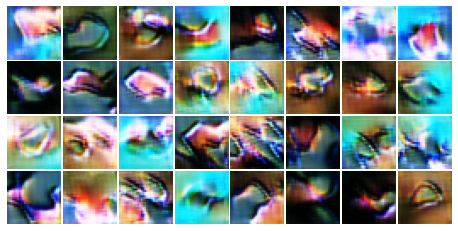

Epoch took 39.404 seconds: d_loss=-113.872,  g_loss=141.282
Epoch 2/200
Epoch took 38.190 seconds: d_loss=-130.023,  g_loss=181.090
Epoch 3/200
Epoch took 38.084 seconds: d_loss=-129.576,  g_loss=182.588
Epoch 4/200
Epoch took 37.979 seconds: d_loss=-138.521,  g_loss=180.793
Epoch 5/200
Epoch took 38.176 seconds: d_loss=-136.099,  g_loss=174.565
Epoch 6/200


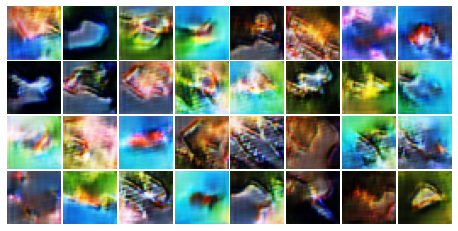

Epoch took 38.561 seconds: d_loss=-126.395,  g_loss=167.387
Epoch 7/200
Epoch took 38.007 seconds: d_loss=-134.964,  g_loss=176.318
Epoch 8/200
Epoch took 37.832 seconds: d_loss=-125.351,  g_loss=167.139
Epoch 9/200
Epoch took 37.872 seconds: d_loss=-133.213,  g_loss=167.128
Epoch 10/200


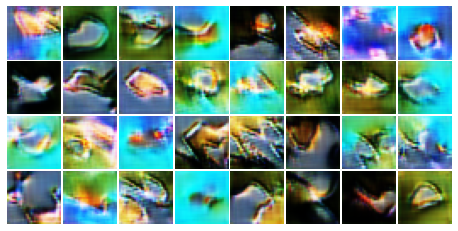

Epoch took 39.639 seconds: d_loss=-136.892,  g_loss=173.853
Epoch 11/200


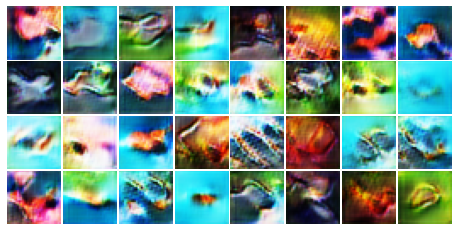

Epoch took 38.818 seconds: d_loss=-135.970,  g_loss=178.361
Epoch 12/200
Epoch took 37.968 seconds: d_loss=-129.594,  g_loss=188.513
Epoch 13/200
Epoch took 37.719 seconds: d_loss=-124.151,  g_loss=184.761
Epoch 14/200
Epoch took 37.780 seconds: d_loss=-144.492,  g_loss=186.748
Epoch 15/200
Epoch took 37.556 seconds: d_loss=-126.818,  g_loss=181.411
Epoch 16/200


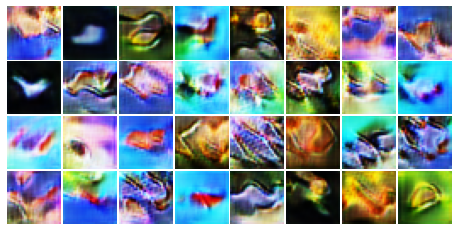

Epoch took 39.030 seconds: d_loss=-147.400,  g_loss=179.465
Epoch 17/200
Epoch took 38.040 seconds: d_loss=-151.045,  g_loss=193.712
Epoch 18/200
Epoch took 38.261 seconds: d_loss=-134.725,  g_loss=189.438
Epoch 19/200
Epoch took 38.534 seconds: d_loss=-159.380,  g_loss=209.966
Epoch 20/200


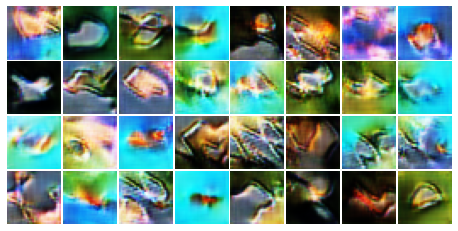

Epoch took 39.409 seconds: d_loss=-146.674,  g_loss=211.787
Epoch 21/200


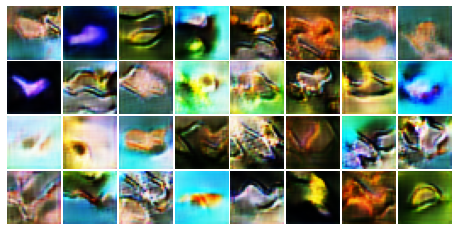

Epoch took 39.558 seconds: d_loss=-152.486,  g_loss=219.760
Epoch 22/200
Epoch took 37.775 seconds: d_loss=-141.200,  g_loss=178.630
Epoch 23/200
Epoch took 37.968 seconds: d_loss=-142.321,  g_loss=190.354
Epoch 24/200
Epoch took 37.931 seconds: d_loss=-154.592,  g_loss=200.070
Epoch 25/200
Epoch took 37.964 seconds: d_loss=-155.884,  g_loss=204.368
Epoch 26/200


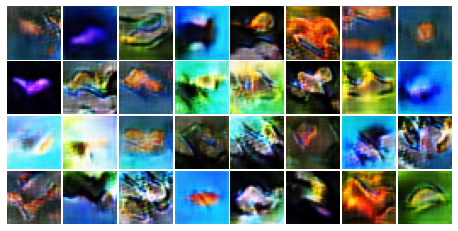

Epoch took 39.415 seconds: d_loss=-152.610,  g_loss=223.905
Epoch 27/200
Epoch took 37.980 seconds: d_loss=-154.628,  g_loss=182.296
Epoch 28/200
Epoch took 38.032 seconds: d_loss=-125.061,  g_loss=166.541
Epoch 29/200
Epoch took 38.299 seconds: d_loss=-131.672,  g_loss=201.615
Epoch 30/200


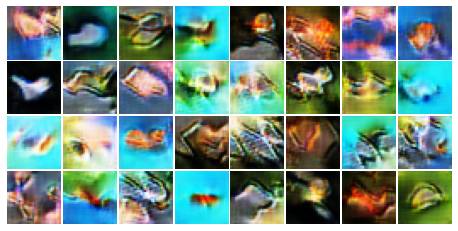

Epoch took 39.058 seconds: d_loss=-125.369,  g_loss=178.746
Epoch 31/200


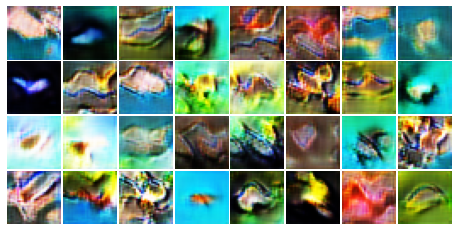

Epoch took 39.336 seconds: d_loss=-138.772,  g_loss=196.856
Epoch 32/200
Epoch took 38.186 seconds: d_loss=-135.320,  g_loss=166.556
Epoch 33/200
Epoch took 38.346 seconds: d_loss=-131.848,  g_loss=184.935
Epoch 34/200
Epoch took 38.717 seconds: d_loss=-137.444,  g_loss=224.041
Epoch 35/200
Epoch took 37.955 seconds: d_loss=-141.073,  g_loss=212.388
Epoch 36/200


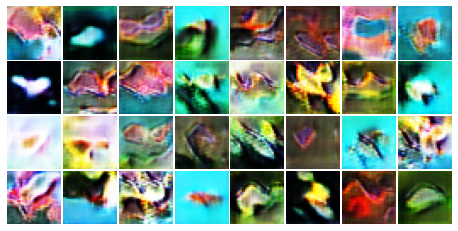

Epoch took 39.361 seconds: d_loss=-106.079,  g_loss=167.256
Epoch 37/200
Epoch took 38.053 seconds: d_loss=-138.026,  g_loss=149.939
Epoch 38/200
Epoch took 38.135 seconds: d_loss=-131.099,  g_loss=175.130
Epoch 39/200
Epoch took 38.262 seconds: d_loss=-120.996,  g_loss=192.089
Epoch 40/200


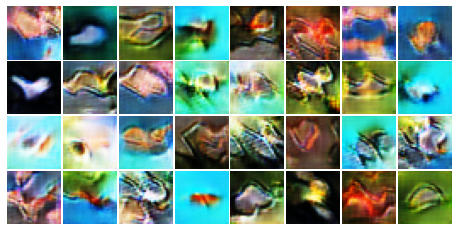

Epoch took 39.384 seconds: d_loss=-104.596,  g_loss=161.180
Epoch 41/200


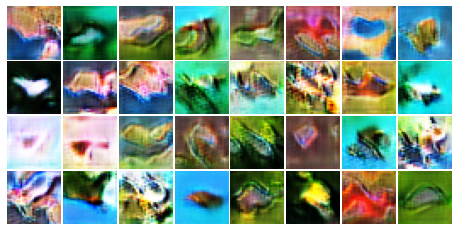

Epoch took 39.342 seconds: d_loss=-110.263,  g_loss=175.130
Epoch 42/200
Epoch took 38.326 seconds: d_loss=-129.623,  g_loss=185.564
Epoch 43/200
Epoch took 38.025 seconds: d_loss=-124.562,  g_loss=184.457
Epoch 44/200
Epoch took 38.425 seconds: d_loss=-109.177,  g_loss=152.393
Epoch 45/200
Epoch took 37.782 seconds: d_loss=-129.993,  g_loss=169.722
Epoch 46/200


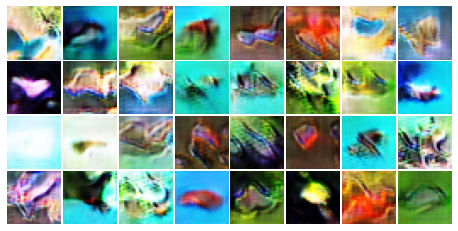

Epoch took 39.271 seconds: d_loss=-106.320,  g_loss=179.033
Epoch 47/200
Epoch took 38.285 seconds: d_loss=-137.420,  g_loss=177.773
Epoch 48/200
Epoch took 38.227 seconds: d_loss=-141.263,  g_loss=199.606
Epoch 49/200
Epoch took 38.803 seconds: d_loss=-122.988,  g_loss=178.873
Epoch 50/200


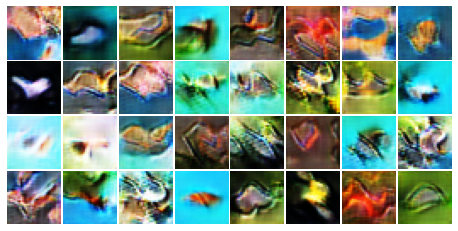

Epoch took 39.964 seconds: d_loss=-115.171,  g_loss=128.793
Epoch 51/200


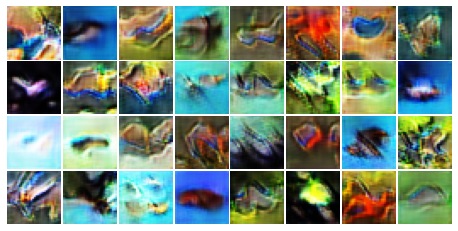

Epoch took 39.435 seconds: d_loss=-117.973,  g_loss=159.303
Epoch 52/200
Epoch took 38.447 seconds: d_loss=-114.971,  g_loss=177.259
Epoch 53/200
Epoch took 38.589 seconds: d_loss=-120.039,  g_loss=163.154
Epoch 54/200
Epoch took 38.286 seconds: d_loss=-122.288,  g_loss=188.169
Epoch 55/200
Epoch took 38.016 seconds: d_loss=-122.903,  g_loss=165.759
Epoch 56/200


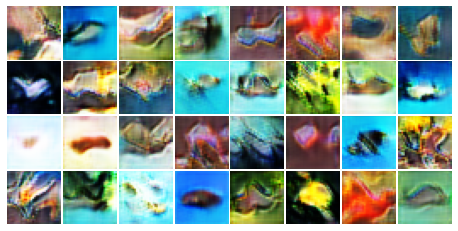

Epoch took 39.495 seconds: d_loss=-132.332,  g_loss=197.047
Epoch 57/200
Epoch took 38.427 seconds: d_loss=-126.852,  g_loss=178.632
Epoch 58/200
Epoch took 38.767 seconds: d_loss=-134.613,  g_loss=178.693
Epoch 59/200
Epoch took 38.295 seconds: d_loss=-131.633,  g_loss=157.616
Epoch 60/200


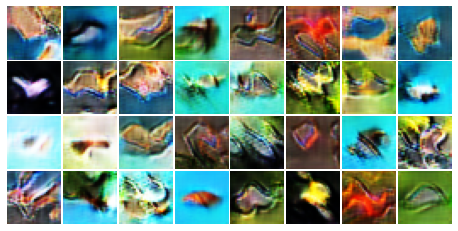

Epoch took 39.801 seconds: d_loss=-134.778,  g_loss=164.896
Epoch 61/200


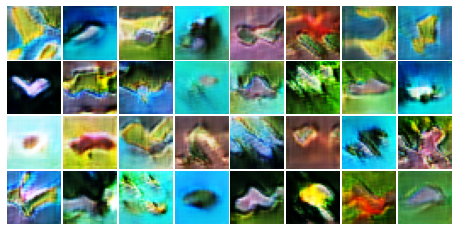

Epoch took 39.376 seconds: d_loss=-148.844,  g_loss=205.594
Epoch 62/200
Epoch took 38.037 seconds: d_loss=-144.351,  g_loss=190.371
Epoch 63/200
Epoch took 38.087 seconds: d_loss=-143.039,  g_loss=189.804
Epoch 64/200
Epoch took 38.181 seconds: d_loss=-135.042,  g_loss=173.907
Epoch 65/200
Epoch took 37.822 seconds: d_loss=-146.960,  g_loss=205.799
Epoch 66/200


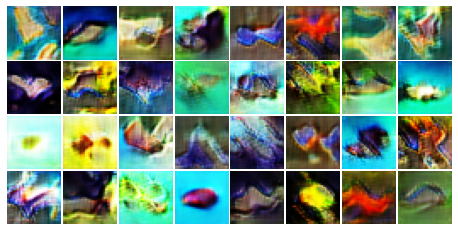

Epoch took 39.599 seconds: d_loss=-137.293,  g_loss=198.087
Epoch 67/200
Epoch took 38.338 seconds: d_loss=-119.919,  g_loss=143.616
Epoch 68/200
Epoch took 39.713 seconds: d_loss=-133.541,  g_loss=185.849
Epoch 69/200
Epoch took 39.353 seconds: d_loss=-123.933,  g_loss=177.726
Epoch 70/200


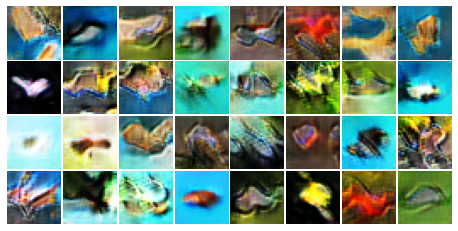

Epoch took 40.126 seconds: d_loss=-135.841,  g_loss=205.639
Epoch 71/200


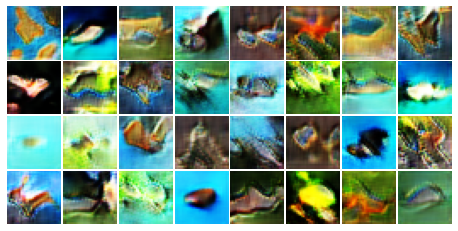

Epoch took 39.737 seconds: d_loss=-126.537,  g_loss=164.274
Epoch 72/200
Epoch took 39.491 seconds: d_loss=-135.328,  g_loss=186.128
Epoch 73/200
Epoch took 39.346 seconds: d_loss=-130.162,  g_loss=202.401
Epoch 74/200
Epoch took 39.309 seconds: d_loss=-144.051,  g_loss=181.246
Epoch 75/200
Epoch took 39.392 seconds: d_loss=-149.707,  g_loss=192.171
Epoch 76/200


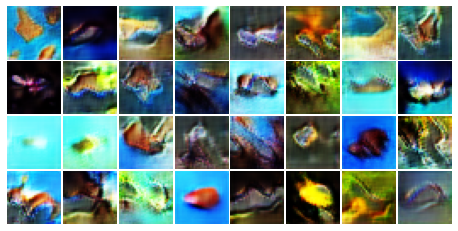

Epoch took 40.273 seconds: d_loss=-132.628,  g_loss=188.140
Epoch 77/200
Epoch took 39.560 seconds: d_loss=-134.995,  g_loss=197.394
Epoch 78/200
Epoch took 39.233 seconds: d_loss=-145.463,  g_loss=176.555
Epoch 79/200
Epoch took 39.052 seconds: d_loss=-135.202,  g_loss=190.714
Epoch 80/200


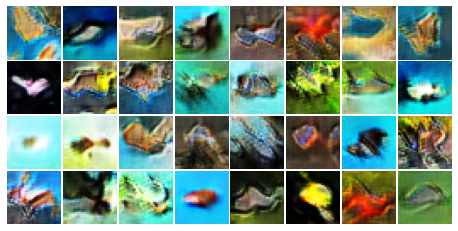

Epoch took 41.070 seconds: d_loss=-126.466,  g_loss=193.149
Epoch 81/200


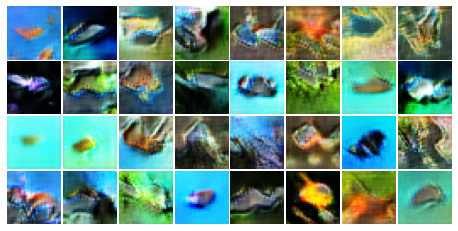

Epoch took 40.075 seconds: d_loss=-133.729,  g_loss=211.752
Epoch 82/200
Epoch took 39.183 seconds: d_loss=-136.399,  g_loss=221.466
Epoch 83/200
Epoch took 39.213 seconds: d_loss=-117.704,  g_loss=190.175
Epoch 84/200
Epoch took 38.385 seconds: d_loss=-122.458,  g_loss=217.838
Epoch 85/200
Epoch took 38.443 seconds: d_loss=-151.333,  g_loss=210.939
Epoch 86/200


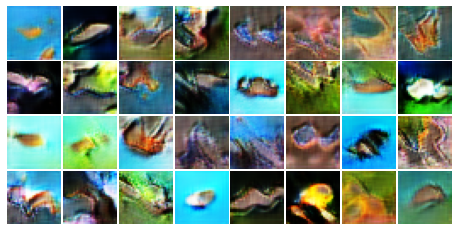

Epoch took 39.359 seconds: d_loss=-135.045,  g_loss=193.412
Epoch 87/200
Epoch took 38.271 seconds: d_loss=-136.374,  g_loss=190.573
Epoch 88/200
Epoch took 38.113 seconds: d_loss=-128.982,  g_loss=172.486
Epoch 89/200
Epoch took 37.866 seconds: d_loss=-129.393,  g_loss=191.371
Epoch 90/200


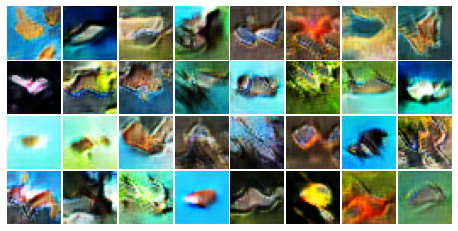

Epoch took 39.678 seconds: d_loss=-130.191,  g_loss=179.961
Epoch 91/200


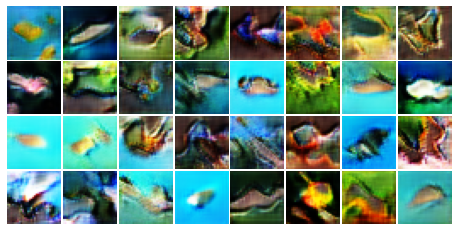

Epoch took 39.200 seconds: d_loss=-129.004,  g_loss=190.803
Epoch 92/200
Epoch took 37.983 seconds: d_loss=-145.839,  g_loss=174.023
Epoch 93/200
Epoch took 38.010 seconds: d_loss=-117.905,  g_loss=161.411
Epoch 94/200
Epoch took 38.482 seconds: d_loss=-142.134,  g_loss=179.194
Epoch 95/200
Epoch took 37.862 seconds: d_loss=-148.715,  g_loss=205.034
Epoch 96/200


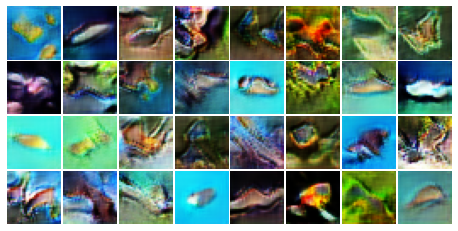

Epoch took 39.386 seconds: d_loss=-140.154,  g_loss=190.492
Epoch 97/200
Epoch took 37.909 seconds: d_loss=-152.521,  g_loss=194.819
Epoch 98/200
Epoch took 37.749 seconds: d_loss=-147.943,  g_loss=217.672
Epoch 99/200
Epoch took 37.984 seconds: d_loss=-131.164,  g_loss=146.166
Epoch 100/200


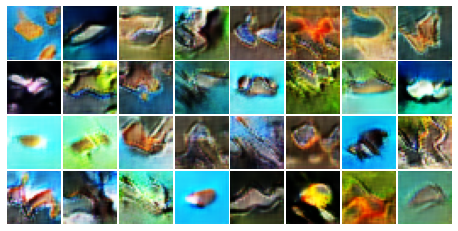

Epoch took 38.987 seconds: d_loss=-146.928,  g_loss=191.189
Epoch 101/200


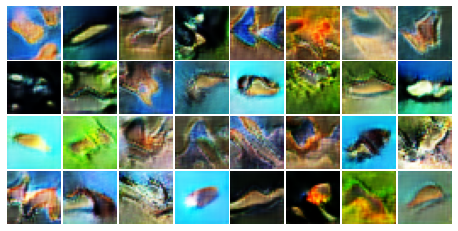

Epoch took 38.939 seconds: d_loss=-154.469,  g_loss=205.299
Epoch 102/200
Epoch took 38.244 seconds: d_loss=-133.513,  g_loss=163.344
Epoch 103/200
Epoch took 38.317 seconds: d_loss=-130.910,  g_loss=171.646
Epoch 104/200
Epoch took 38.399 seconds: d_loss=-136.356,  g_loss=184.654
Epoch 105/200
Epoch took 37.916 seconds: d_loss=-134.649,  g_loss=237.286
Epoch 106/200


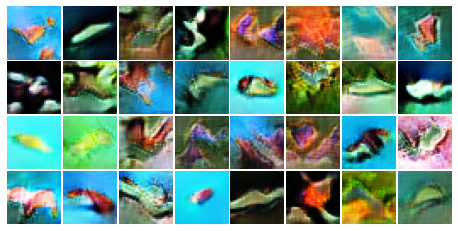

Epoch took 39.316 seconds: d_loss=-134.853,  g_loss=194.375
Epoch 107/200
Epoch took 37.868 seconds: d_loss=-143.053,  g_loss=173.050
Epoch 108/200
Epoch took 37.849 seconds: d_loss=-124.466,  g_loss=183.275
Epoch 109/200
Epoch took 37.777 seconds: d_loss=-123.194,  g_loss=154.138
Epoch 110/200


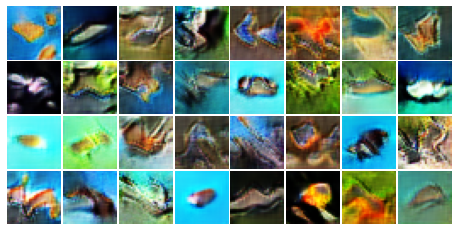

Epoch took 39.016 seconds: d_loss=-145.386,  g_loss=197.988
Epoch 111/200


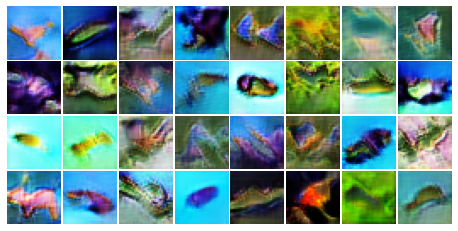

Epoch took 39.705 seconds: d_loss=-142.730,  g_loss=191.671
Epoch 112/200
Epoch took 38.253 seconds: d_loss=-155.469,  g_loss=252.105
Epoch 113/200
Epoch took 38.767 seconds: d_loss=-129.751,  g_loss=191.484
Epoch 114/200
Epoch took 38.366 seconds: d_loss=-136.600,  g_loss=175.535
Epoch 115/200
Epoch took 37.687 seconds: d_loss=-140.729,  g_loss=197.663
Epoch 116/200


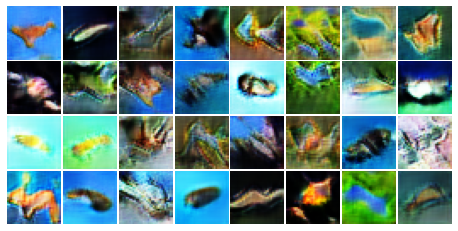

Epoch took 39.181 seconds: d_loss=-146.098,  g_loss=207.179
Epoch 117/200
Epoch took 38.387 seconds: d_loss=-149.230,  g_loss=185.679
Epoch 118/200
Epoch took 37.612 seconds: d_loss=-142.580,  g_loss=192.669
Epoch 119/200
Epoch took 38.126 seconds: d_loss=-122.008,  g_loss=202.491
Epoch 120/200


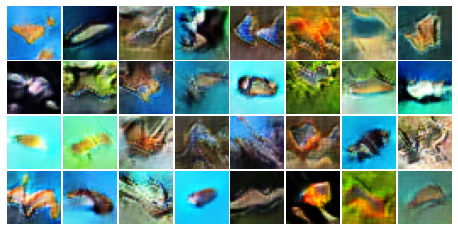

Epoch took 40.627 seconds: d_loss=-129.494,  g_loss=202.479
Epoch 121/200


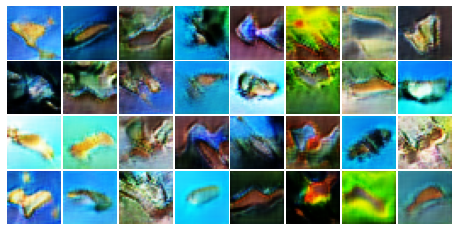

Epoch took 40.515 seconds: d_loss=-137.424,  g_loss=187.148
Epoch 122/200
Epoch took 39.291 seconds: d_loss=-125.786,  g_loss=151.055
Epoch 123/200
Epoch took 39.086 seconds: d_loss=-135.104,  g_loss=184.960
Epoch 124/200
Epoch took 39.276 seconds: d_loss=-138.723,  g_loss=196.010
Epoch 125/200
Epoch took 39.229 seconds: d_loss=-137.425,  g_loss=182.668
Epoch 126/200


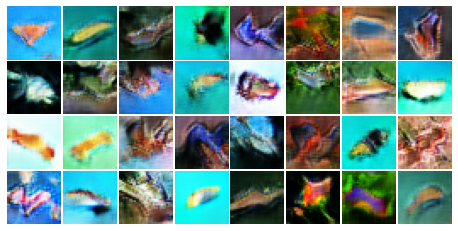

Epoch took 41.446 seconds: d_loss=-134.935,  g_loss=213.465
Epoch 127/200
Epoch took 39.606 seconds: d_loss=-132.430,  g_loss=170.955
Epoch 128/200
Epoch took 39.446 seconds: d_loss=-128.299,  g_loss=188.237
Epoch 129/200
Epoch took 38.998 seconds: d_loss=-134.052,  g_loss=189.126
Epoch 130/200


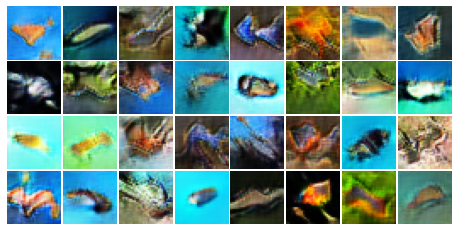

Epoch took 41.067 seconds: d_loss=-117.860,  g_loss=150.921
Epoch 131/200


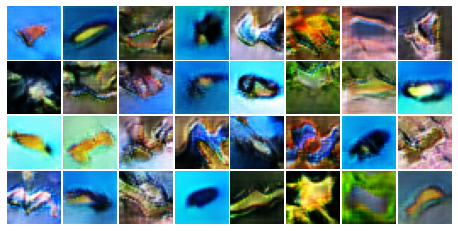

Epoch took 40.431 seconds: d_loss=-124.917,  g_loss=169.127
Epoch 132/200
Epoch took 39.331 seconds: d_loss=-125.909,  g_loss=171.901
Epoch 133/200
Epoch took 39.038 seconds: d_loss=-132.772,  g_loss=173.214
Epoch 134/200
Epoch took 39.206 seconds: d_loss=-117.451,  g_loss=185.657
Epoch 135/200
Epoch took 39.517 seconds: d_loss=-138.075,  g_loss=207.988
Epoch 136/200


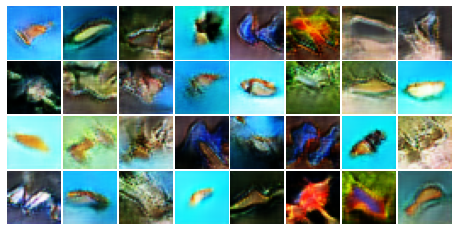

Epoch took 40.365 seconds: d_loss=-112.969,  g_loss=164.763
Epoch 137/200
Epoch took 38.827 seconds: d_loss=-126.775,  g_loss=210.654
Epoch 138/200
Epoch took 38.696 seconds: d_loss=-131.270,  g_loss=198.544
Epoch 139/200
Epoch took 38.410 seconds: d_loss=-151.980,  g_loss=233.141
Epoch 140/200


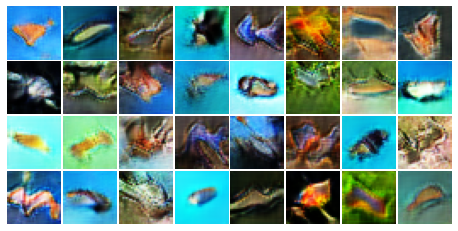

Epoch took 39.672 seconds: d_loss=-135.502,  g_loss=217.064
Epoch 141/200


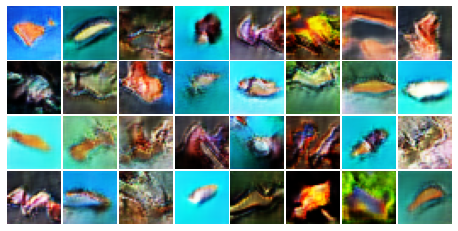

Epoch took 39.806 seconds: d_loss=-143.290,  g_loss=199.260
Epoch 142/200
Epoch took 38.278 seconds: d_loss=-144.649,  g_loss=202.366
Epoch 143/200
Epoch took 38.974 seconds: d_loss=-124.958,  g_loss=180.678
Epoch 144/200
Epoch took 38.903 seconds: d_loss=-131.653,  g_loss=232.571
Epoch 145/200
Epoch took 38.315 seconds: d_loss=-136.092,  g_loss=231.793
Epoch 146/200


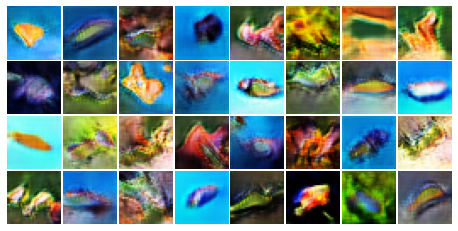

Epoch took 39.877 seconds: d_loss=-144.540,  g_loss=182.794
Epoch 147/200
Epoch took 38.652 seconds: d_loss=-144.785,  g_loss=222.734
Epoch 148/200
Epoch took 38.547 seconds: d_loss=-130.294,  g_loss=197.415
Epoch 149/200
Epoch took 38.216 seconds: d_loss=-132.055,  g_loss=194.003
Epoch 150/200


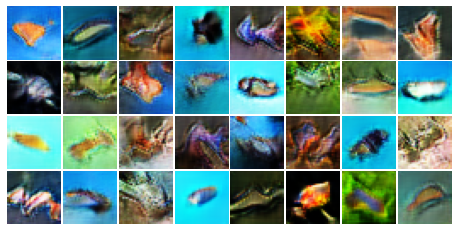

Epoch took 39.988 seconds: d_loss=-159.688,  g_loss=219.045
Epoch 151/200


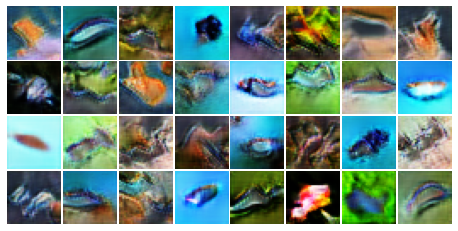

Epoch took 39.787 seconds: d_loss=-148.623,  g_loss=246.602
Epoch 152/200
Epoch took 38.348 seconds: d_loss=-147.771,  g_loss=228.820
Epoch 153/200
Epoch took 38.472 seconds: d_loss=-146.002,  g_loss=216.239
Epoch 154/200
Epoch took 39.012 seconds: d_loss=-152.326,  g_loss=215.701
Epoch 155/200
Epoch took 38.609 seconds: d_loss=-129.799,  g_loss=222.468
Epoch 156/200


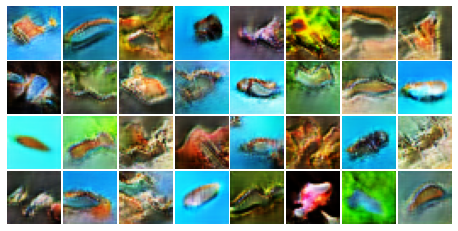

Epoch took 39.702 seconds: d_loss=-152.668,  g_loss=227.578
Epoch 157/200
Epoch took 39.155 seconds: d_loss=-136.829,  g_loss=207.457
Epoch 158/200
Epoch took 38.724 seconds: d_loss=-138.566,  g_loss=178.019
Epoch 159/200
Epoch took 38.473 seconds: d_loss=-120.720,  g_loss=183.758
Epoch 160/200


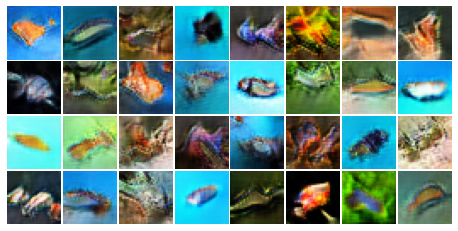

Epoch took 40.140 seconds: d_loss=-141.608,  g_loss=233.534
Epoch 161/200


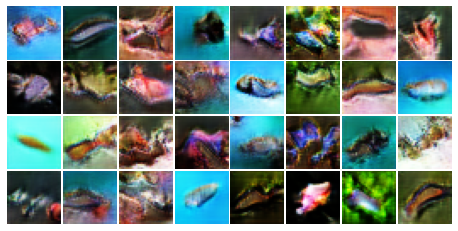

Epoch took 39.372 seconds: d_loss=42.241,  g_loss=166.894
Epoch 162/200
Epoch took 39.086 seconds: d_loss=-161.670,  g_loss=213.174
Epoch 163/200
Epoch took 38.420 seconds: d_loss=-145.153,  g_loss=211.809
Epoch 164/200
Epoch took 38.150 seconds: d_loss=-127.205,  g_loss=203.830
Epoch 165/200
Epoch took 38.205 seconds: d_loss=-139.647,  g_loss=199.643
Epoch 166/200


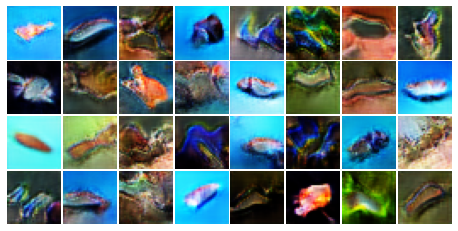

Epoch took 39.567 seconds: d_loss=-123.026,  g_loss=180.620
Epoch 167/200
Epoch took 38.446 seconds: d_loss=-128.124,  g_loss=197.782
Epoch 168/200
Epoch took 38.371 seconds: d_loss=-135.563,  g_loss=194.809
Epoch 169/200
Epoch took 38.422 seconds: d_loss=-115.742,  g_loss=200.324
Epoch 170/200


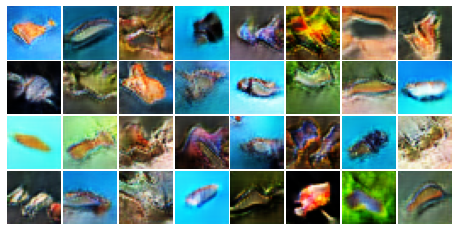

Epoch took 39.589 seconds: d_loss=-114.761,  g_loss=187.859
Epoch 171/200


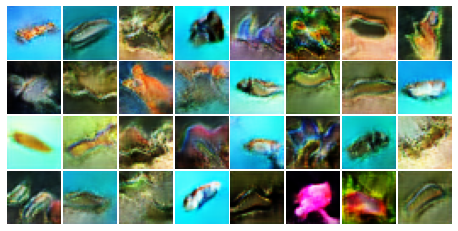

Epoch took 40.018 seconds: d_loss=-146.423,  g_loss=235.936
Epoch 172/200
Epoch took 38.227 seconds: d_loss=-140.713,  g_loss=175.728
Epoch 173/200
Epoch took 38.546 seconds: d_loss=-133.244,  g_loss=190.434
Epoch 174/200
Epoch took 38.454 seconds: d_loss=-141.075,  g_loss=221.629
Epoch 175/200
Epoch took 38.558 seconds: d_loss=-132.441,  g_loss=169.312
Epoch 176/200


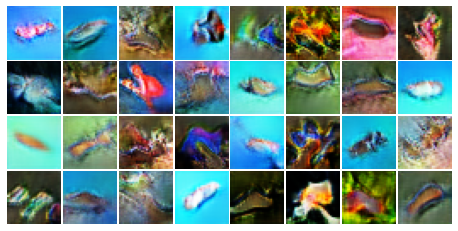

Epoch took 39.593 seconds: d_loss=-151.435,  g_loss=216.529
Epoch 177/200
Epoch took 38.473 seconds: d_loss=-138.288,  g_loss=212.267
Epoch 178/200
Epoch took 38.615 seconds: d_loss=-145.828,  g_loss=208.779
Epoch 179/200
Epoch took 38.153 seconds: d_loss=-129.042,  g_loss=193.290
Epoch 180/200


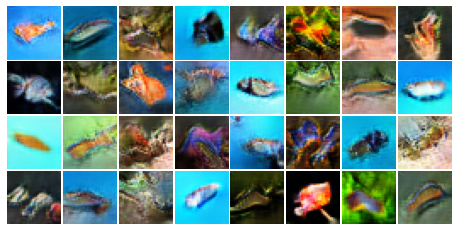

Epoch took 39.701 seconds: d_loss=-133.587,  g_loss=199.516
Epoch 181/200


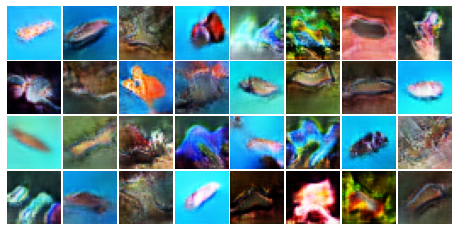

Epoch took 39.432 seconds: d_loss=-118.265,  g_loss=206.778
Epoch 182/200
Epoch took 38.565 seconds: d_loss=-131.056,  g_loss=183.834
Epoch 183/200
Epoch took 38.652 seconds: d_loss=-124.249,  g_loss=197.167
Epoch 184/200
Epoch took 38.544 seconds: d_loss=-128.216,  g_loss=163.827
Epoch 185/200
Epoch took 38.819 seconds: d_loss=-136.068,  g_loss=200.890
Epoch 186/200


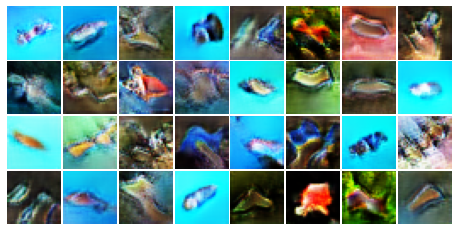

Epoch took 39.838 seconds: d_loss=-128.807,  g_loss=196.055
Epoch 187/200
Epoch took 37.928 seconds: d_loss=-125.668,  g_loss=197.308
Epoch 188/200
Epoch took 37.770 seconds: d_loss=-110.685,  g_loss=185.752
Epoch 189/200
Epoch took 38.181 seconds: d_loss=-130.096,  g_loss=204.909
Epoch 190/200


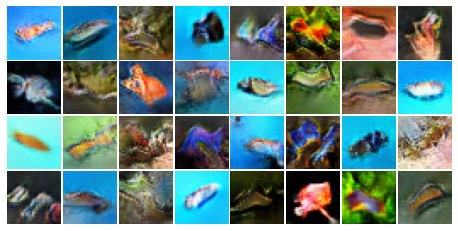

Epoch took 39.484 seconds: d_loss=-148.093,  g_loss=238.243
Epoch 191/200


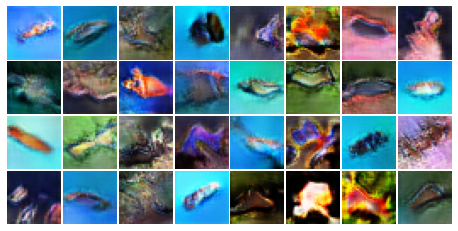

Epoch took 38.785 seconds: d_loss=-132.291,  g_loss=206.972
Epoch 192/200
Epoch took 38.032 seconds: d_loss=-132.320,  g_loss=184.579
Epoch 193/200
Epoch took 38.059 seconds: d_loss=-135.365,  g_loss=196.215
Epoch 194/200
Epoch took 39.818 seconds: d_loss=-140.773,  g_loss=233.317
Epoch 195/200
Epoch took 38.747 seconds: d_loss=-121.589,  g_loss=181.003
Epoch 196/200


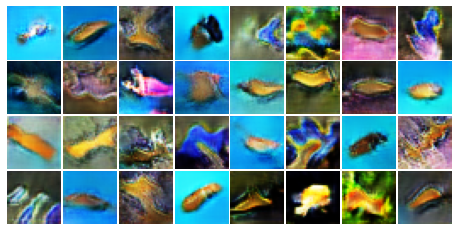

Epoch took 39.941 seconds: d_loss=-107.709,  g_loss=243.498
Epoch 197/200
Epoch took 38.766 seconds: d_loss=-152.176,  g_loss=193.171
Epoch 198/200
Epoch took 38.292 seconds: d_loss=-151.599,  g_loss=243.429
Epoch 199/200
Epoch took 38.265 seconds: d_loss=-142.522,  g_loss=225.615
Epoch 200/200


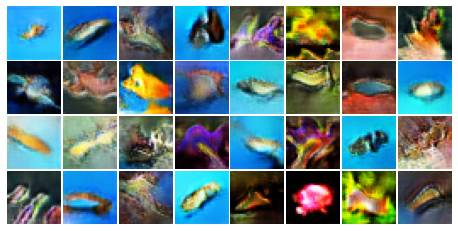

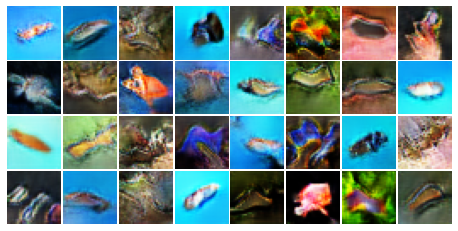

Epoch took 40.820 seconds: d_loss=-129.814,  g_loss=185.284


In [28]:
wgan.d_optimizer.lr = 0.0001
wgan.g_optimizer.lr = 0.0001
avgan = train_wgan_withav(wgan, dataset, batch_size, codings_size, 32, n_epochs=200,iCount=0)

In [ ]:
wgan.d_optimizer.lr = 0.00003
wgan.g_optimizer.lr = 0.00003
avgan = train_wgan_withav(wgan, dataset, batch_size, codings_size, 32, n_epochs=500,iCount=20)

In [ ]:
wgan.d_optimizer.lr = 0.0005
wgan.g_optimizer.lr = 0.0005
avgan = train_wgan_withav(wgan, dataset, batch_size, codings_size, 32, avmodel=avgan, n_epochs=200,iCount=35)

In [30]:
modname="32_DCGAN"
saveh5s(wgan,modname)
saveh5(avgan,'avgen'+modname)
!tar -czf gif32DC.tar.gz GIFs
dump_hists(d_loss_hist,g_loss_hist,modname)

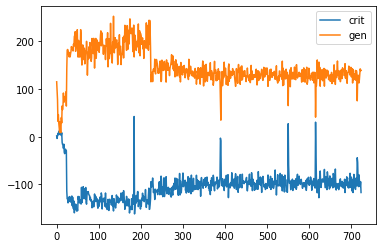

In [32]:
plot_history(d_loss_hist[15:], g_loss_hist[15:])

In [ ]:
generator, critic = loadh5s(loadmodelname)



# Generate from an existing h5 (version saved without fading)

In [5]:
d_loss_hist, g_loss_hist = load_hists(tag="32_WGAN-GP")

loadmodelname = "32_WGAN-GP"
h5inDIR = "./"
generator, critic = loadh5s(loadmodelname)
avgenerator = load_model("avgen32_WGAN-GP.h5",custom_objects=customOs)

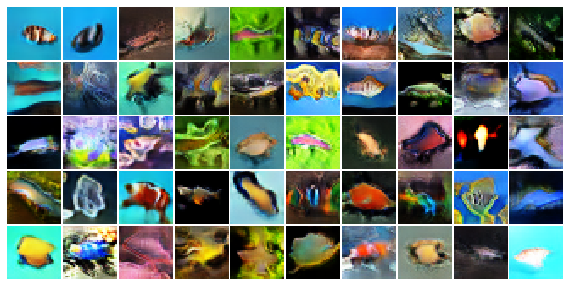

In [45]:
noise = tf.random.normal(shape=[50, codings_size])
figs = avgenerator(noise)
plot_multiple_images(figs, 10)

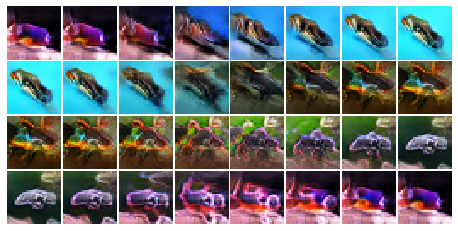

In [44]:
vecA = noise[117]
vecB = noise[89]
vecC = noise[53]
vecD = noise[4]
step = 7
diffvec1 = (vecB-vecA)/step
diffvec2 = (vecC-vecB)/step
diffvec3 = (vecD-vecC)/step
diffvec4 = (vecA-vecD)/step
newNoise1 = [vecA + (i)*diffvec1 for i in range(step+1)]
newNoise2 = [vecB + (i)*diffvec2 for i in range(step+1)]
newNoise3 = [vecC + (i)*diffvec3 for i in range(step+1)]
newNoise4 = [vecD + (i)*diffvec4 for i in range(step+1)]
newNoise=newNoise1+newNoise2+newNoise3+newNoise4
figs2 = avgenerator(np.array(newNoise))
plot_multiple_images(figs2, 8)
frames_path = "RoughTransition.png"
plt.savefig(frames_path)
plt.show()    #note: show before save has the file blank
plt.close()

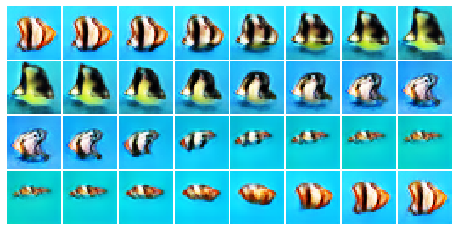

In [20]:
vecA = noise[55]
vecB = noise[52]
vecC = noise[56]
vecD = noise[40]
step = 7
diffvec1 = (vecB-vecA)/step
diffvec2 = (vecC-vecB)/step
diffvec3 = (vecD-vecC)/step
diffvec4 = (vecA-vecD)/step
newNoise1 = [vecA + (i)*diffvec1 for i in range(step+1)]
newNoise2 = [vecB + (i)*diffvec2 for i in range(step+1)]
newNoise3 = [vecC + (i)*diffvec3 for i in range(step+1)]
newNoise4 = [vecD + (i)*diffvec4 for i in range(step+1)]
newNoise=newNoise1+newNoise2+newNoise3+newNoise4
figs2 = avgenerator(np.array(newNoise))
plot_multiple_images(figs2, 8)
frames_path = "SmoothTransition.png"
plt.savefig(frames_path)
plt.show()    #note: show before save has the file blank
plt.close()

In [21]:
GIFDIR="./GIFs/"
def constructGIF(filename,ix):
    gif_path = GIFDIR+filename+".gif"
    frames_path = GIFDIR+filename+"_{i}.png"
    with imageio.get_writer(gif_path, mode='I') as writer:
        for i in range(ix):
            writer.append_data(imageio.imread(frames_path.format(i=i)))

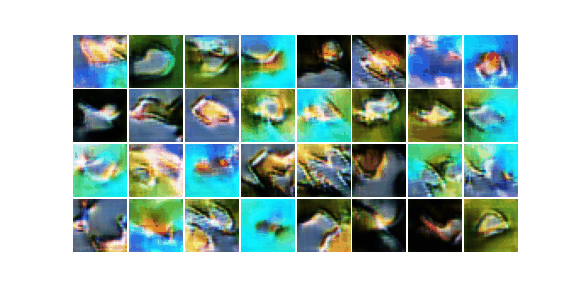

In [46]:
constructGIF("dcwgan_test",160)
IpyImage(filename=GIFDIR+"dcwgan_test"+".gif")

In [71]:
from contextlib import redirect_stdout

def output_summary_to_text(model,file):
    with open(file+'summary.txt', 'w') as f:
        with redirect_stdout(f):
            model.summary()

output_summary_to_text(generator,"genWGAN-GP_32_")
output_summary_to_text(critic,"critWGAN-GP_32_")

In [72]:
generator.summary()
critic.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 8192)              2105344   
_________________________________________________________________
reshape_3 (Reshape)          (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose_15 (Conv2DT (None, 8, 8, 128)         409728    
_________________________________________________________________
pixel_norm_12 (PixelNorm)    (None, 8, 8, 128)         0         
_________________________________________________________________
leaky_re_lu_30 (LeakyReLU)   (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose_16 (Conv2DT (None, 8, 8, 128)         262272    
_________________________________________________________________
pixel_norm_13 (PixelNorm)    (None, 8, 8, 128)        

In [ ]:
# Two Time-Scale Update Rule: https://arxiv.org/pdf/1706.08500.pdf
#   This was tried, and seems to result in the dicriminator getting too good and causing a runaway
# Adam with beta1 = 0 is just RMS prop (with the boost at the beginning of training)
optimizercrit=Adam(lr=0.0005, beta_1=0, beta_2=0.99, epsilon=1e-8)
optimizergen=Adam(lr=0.0005, beta_1=0, beta_2=0.99, epsilon=1e-8)
# consider switching to RMSprop since the initial jump isn't helpful 
#optimizercrit=RMSprop(lr=0.001, rho=0.99, epsilon=1e-8)
#optimizergen=RMSprop(lr=0.001, rho=0.99, epsilon=1e-8)

#with strategy.scope():
# compile first
wganCur = WGANGP(discriminator=ini_critic,generator=ini_generator,latent_dim=codings_size,discriminator_steps=1)
wganCur.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)
# compile standard
wganNext = WGANGP(discriminator=newcritics[0],generator=newgens[0],latent_dim=codings_size,discriminator_steps=1)
wganNext.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)
# compile fade
wganFade = WGANGP(discriminator=newcritics[1],generator=newgens[1],latent_dim=codings_size,discriminator_steps=1)
wganFade.compile(d_optimizer=optimizercrit,g_optimizer=optimizergen,g_loss_fn=generator_loss,d_loss_fn=critic_loss)

In [ ]:
if setFade:
    wganFade.nMaxFade = fadenImages
else:
    wganFade.nMaxFade = 0
    print('Warning: no Fade set')

train_wgan(wganFade, dataset, batch_size, codings_size, newlevel, n_epochs=800, iCount=135)
saveh5s(wganNext,'32_4mid')
!tar -czf gif32.tar.gz GIFs
dump_hists(d_loss_hist,g_loss_hist,'_32_4mid')
avgan = train_wgan_withav(wganNext, dataset, batch_size, codings_size, newlevel, n_epochs=800, iCount=176)
saveh5s(wganNext,'32_4')
saveh5(avgan,'avgen_32_4')
!tar -czf gif32.tar.gz GIFs
dump_hists(d_loss_hist,g_loss_hist,'_32_4')

# Dynamic learning rate adjustments experiment

In [ ]:
def adjust_lr(opt,lrmax=0.001,lrmin=0.0001):
    # randomly assign a learning rate to both the discriminator and generator each iteration
    newlr = np.exp( tf.random.uniform(shape=(),maxval=1.)*(np.log(lrmax)-np.log(lrmin)) + np.log(lrmin))
    opt.lr = newlr

def adjust_lr(opt,lrmax=0.001,lrmin=0.0001):
    # randomly assign a learning rate to both the discriminator and generator each iteration
    newlr = 1./(1./lrmax + tf.random.uniform(shape=(),maxval=1./lrmin))
    opt.lr = newlr

def adjust_lr_prob(opt,lrhigh=0.005,prob=0.003,lrmax=0.001,lrmin=0.00005):#,lrmax=0.001,lrmin=0.0001):
    # randomly assign a learning rate to both the discriminator and generator each iteration
    if tf.random.uniform(shape=(),maxval=1.) < prob:
        opt.lr = lrhigh
    else:
        adjust_lr(opt,lrmax=lrmax,lrmin=lrmin)

# implementation of wasserstein loss with gradient penalty
# Useful information: https://medium.com/@jonathan_hui/gan-wasserstein-gan-wgan-gp-6a1a2aa1b490
# keras implementation: https://keras.io/examples/generative/wgan_gp/
class WGANGP_rnd_lr(keras.Model):
    def __init__(
        self,
        discriminator,
        generator,
        latent_dim,
        discriminator_steps=1,
        gp_weight=10.0,
        #nMaxFade = 800000 this is the recommended value for faces
        nMaxFade = 100000
    ):
        super(WGANGP_rnd_lr, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_steps = discriminator_steps
        self.gp_weight = gp_weight
        self.nMaxFade = nMaxFade
        self.fade = 0.0
        self.nRunFade = 0
        self.trainFreeze = False

    def compile(self, d_optimizer, g_optimizer, d_loss_fn, g_loss_fn):
        super(WGANGP_rnd_lr, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_fn = d_loss_fn
        self.g_loss_fn = g_loss_fn
        
    def get_config(self):
        base_config = super(keras.Model,self).get_config()
        base_config["discriminator"] = self.discriminator
        base_config["d_optimizer"] = self.d_optimizer
        base_config["d_loss_fn"] = self.d_loss_fn
        base_config["generator"] = self.generator
        base_config["g_loss_fn"] = self.g_loss_fn
        base_config["g_optimizer"] = self.g_optimizer
        base_config["latent_dim"] = self.latent_dim
        base_config["discriminator_steps"] = self.d_steps
        base_config["gp_weight"] = self.gp_weight
        base_config["nMaxFade"] = self.nMaxFade
        return base_config

    def gradient_penalty(self, batch_size, real_images, fake_images):
        """ Calculates the gradient penalty.

        This loss is calculated on an interpolated image
        and added to the discriminator loss.
        """
        # get the interplated image
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            # 1. Get the discriminator output for this interpolated image.
            pred = self.discriminator(interpolated, training=True)

        # 2. Calculate the gradients w.r.t to this interpolated image.
        grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Calcuate the norm of the gradients
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images, withFade = True):
        if isinstance(real_images, tuple):
            real_images = real_images[0]

        # Get the batch size
        batch_size = tf.shape(real_images)[0]
        
        #print("Batch Size {}".format(batch_size))
        
        # update the fade is model is being run with fade
        if self.fade < 1:
            if withFade and not self.trainFreeze:
                self.nRunFade += batch_size
                self.fade = min(self.nRunFade,self.nMaxFade)/self.nMaxFade
                update_fade(self.generator,self.fade)
                update_fade(self.discriminator,self.fade)

        # For each batch, we are going to perform the
        # following steps as laid out in the original paper.
        # 1. Train the generator and get the generator loss
        # 2. Train the discriminator and get the discriminator loss
        # 3. Calculate the gradient penalty
        # 4. Multiply this gradient penalty with a constant weight factor
        # 5. Add gradient penalty to the discriminator loss
        # 6. Return generator and discriminator losses as a loss dictionary.

        # Train discriminator first. The original paper recommends training
        # the discriminator for `x` more steps (typically 5) as compared to
        # one step of the generator. Here we will train it for 3 extra steps
        # as compared to 5 to reduce the training time.
        for i in range(self.d_steps):
            # Get the latent vector
            random_latent_vectors = tf.random.normal(
                shape=(batch_size, self.latent_dim)
            )
            with tf.GradientTape() as tape:
                # Generate fake images from the latent vector
                fake_images = self.generator(random_latent_vectors, training=True)
                # Get the logits for the fake images
                fake_logits = self.discriminator(fake_images, training=True)
                # Get the logits for real images
                real_logits = self.discriminator(real_images, training=True)

                # Calculate discriminator loss using fake and real logits
                d_cost = self.d_loss_fn(real_img=real_logits, fake_img=fake_logits)
                # Calculate the gradient penalty
                gp = self.gradient_penalty(batch_size, real_images, fake_images)
                # Add the gradient penalty to the original discriminator loss
                d_loss = d_cost + gp * self.gp_weight

            # Get the gradients w.r.t the discriminator loss
            d_gradient = tape.gradient(d_loss, self.discriminator.trainable_variables)
            # Update the weights of the discriminator using the discriminator optimizer

            #adjust_lr(self.d_optimizer)
            self.d_optimizer.apply_gradients(
                zip(d_gradient, self.discriminator.trainable_variables)
            )

        # Train the generator now.
        # Get the latent vector
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            # Generate fake images using the generator
            generated_images = self.generator(random_latent_vectors, training=True)
            # Get the discriminator logits for fake images
            gen_img_logits = self.discriminator(generated_images, training=True)
            # Calculate the generator loss
            g_loss = self.g_loss_fn(gen_img_logits)

        # Get the gradients w.r.t the generator loss
        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        
        #adjust_lr_prob(self.g_optimizer,lrhigh=0.005,prob=0.002)
        # Update the weights of the generator using the generator optimizer
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )
        return {"d_loss": d_loss, "g_loss": g_loss}


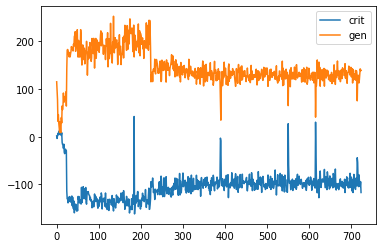

In [32]:
plot_history(d_loss_hist[15:], g_loss_hist[15:])

In [ ]:
!kill -9 -1